In [1]:
import pandas as pd # import pandas library for read file and data preprocessing
import numpy as np  # import numpy libray for numerical calculation
import matplotlib.pyplot as plt # import matplotlib for data visulization
import seaborn as sns #import seaborn for data visulization
%matplotlib inline

In [2]:
data=pd.read_csv('Bias_correction_ucl.csv') #reading CSV file in pandas DataFrame.

In [3]:
pd.set_option('display.max_rows', None) # to show all the rows of DataFrame
pd.set_option('display.max_columns', None) # to show all the columns of DataFrame

In [4]:
data.head() # Showing head of dataframe

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [5]:
data.info() # to show datatypes of each columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [6]:
data.describe() # to see five point summary of numerical columns.

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,0.356080,0.318404,0.299191,0.591995,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,0.258061,0.250362,0.254348,1.945768,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,0.140615,0.101388,0.081532,0.000000,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,0.312421,0.262555,0.227664,0.000000,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,0.558694,0.496703,0.499489,0.052525,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [7]:
data.isna().sum() # To show all nan value in data

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [8]:
#data=data.iloc[:-2,:]

In [9]:
data.iloc[:,2]=data.iloc[:,2].fillna(data.iloc[:,2].median()) # fill all the nan value with median

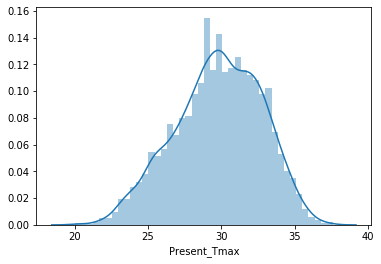

In [10]:
sns.distplot(data.iloc[:,2]) # distribution plot of after filling missing valuse

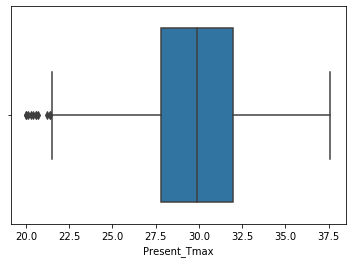

In [11]:
sns.boxplot(data.iloc[:,2]) # boxplot before removing outliers

In [12]:
Present_Tmax_IQR=data.iloc[:,2].quantile(0.75)-data.iloc[:,2].quantile(0.25) # calculating Inter Quantile Range of present_Tmax

In [13]:
Present_Tmax_IQR

4.199999999999999

In [14]:
data.iloc[:,2].quantile(0.25)-1.5*Present_Tmax_IQR # calculating lower wisker of Present_Tmax how to detect outliers

21.5

In [15]:
data.iloc[:,2]=np.where(data.iloc[:,2] <21.5,21.5,data.iloc[:,2]) #removing outliers

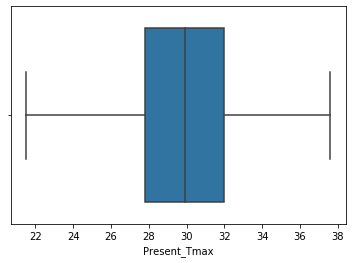

In [16]:
sns.boxplot(data.iloc[:,2]) # boxplot after removing outliers

In [17]:
data.iloc[:,3]=data.iloc[:,3].fillna(data.iloc[:,3].median()) #filling missing value

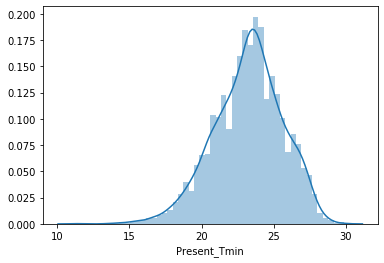

In [18]:
sns.distplot(data.iloc[:,3]) # after filling missing value distribution plot of Present_Tmin

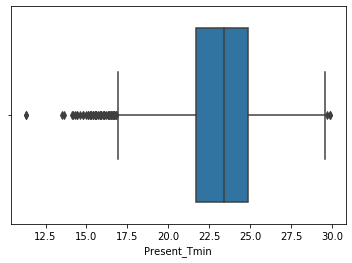

In [19]:
sns.boxplot(data.iloc[:,3]) # create boxplot after filling missing value to detect outliers of Present_Tmin

In [20]:
Present_T_minIQR=data.iloc[:,3].quantile(0.75) - data.iloc[:,3].quantile(0.25) #calculating inter quantile range.

In [21]:
Present_T_minIQR

3.1999999999999993

In [22]:
data.iloc[:,3].quantile(0.25) - 1.5*Present_T_minIQR #calculating lower wistker value.

16.9

In [23]:
data.iloc[:,3].quantile(0.75) + 1.5*Present_T_minIQR #calculating lower wistker value.

29.699999999999996

In [24]:
data.iloc[:,3]=np.where(data.iloc[:,3] < 16.93750,16.93750,data.iloc[:,3]) #removing outliers

In [25]:
data.iloc[:,3]=np.where(data.iloc[:,3] > 29.63,29.63,data.iloc[:,3]) #removing outliers

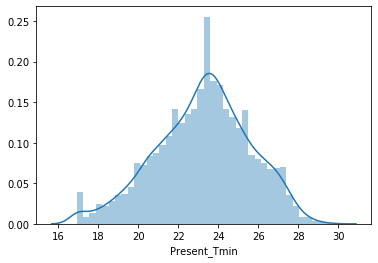

In [26]:
sns.distplot(data.iloc[:,3]) # distribution plot after removing outliers

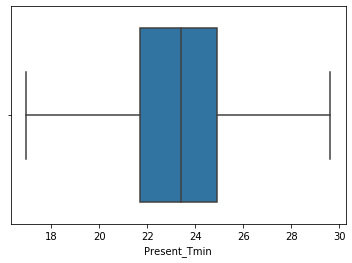

In [27]:
sns.boxplot(data.iloc[:,3])

In [28]:
data.iloc[:,4]=data.iloc[:,4].fillna(data.iloc[:,4].mean()) # filling missing value of LDAPS_RHmin feature

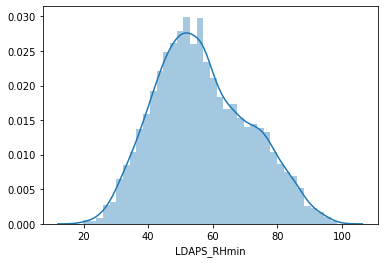

In [29]:
sns.distplot(data.iloc[:,4]) #  distribution of  LDAPS_RHmin after filling missing value 

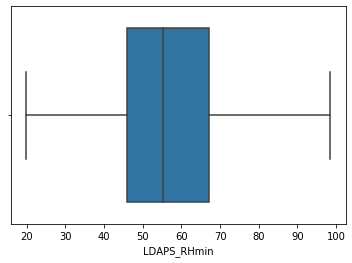

In [30]:
sns.boxplot(data.iloc[:,4]) # box plot for outliers detection of LDAPS_RHmin feature

In [31]:
data.iloc[:,5]=data.iloc[:,5].fillna(data.iloc[:,5].median()) # filling missing value

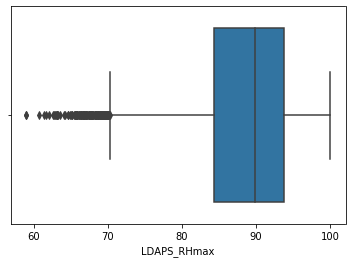

In [32]:
sns.boxplot(data.iloc[:,5]) # box plot of LDAPS_RHmax after filling missing value to check outlier

In [33]:
LDAPS_RH_max_IQR=data.iloc[:,5].quantile(0.75) - data.iloc[:,5].quantile(0.25) #calculating inter quantile range.

In [34]:
LDAPS_RH_max_IQR

9.387577057499996

In [35]:
data.iloc[:,5].quantile(0.25) - 1.5*LDAPS_RH_max_IQR #calculating lower wistker value.

70.23555755375

In [36]:
data.iloc[:,5].quantile(0.75) + 1.5*LDAPS_RH_max_IQR #calculating upper wistker value

107.78586578374998

In [37]:
data.iloc[:,5]=np.where(data.iloc[:,5] < 70.2413864,70.2413864,data.iloc[:,5]) #removing outliers

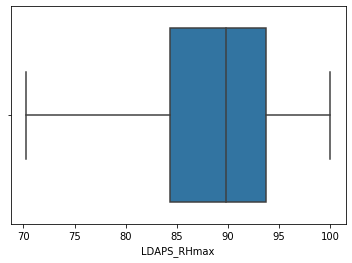

In [38]:
sns.boxplot(data.iloc[:,5]) # creating boxplot after removing outliers.

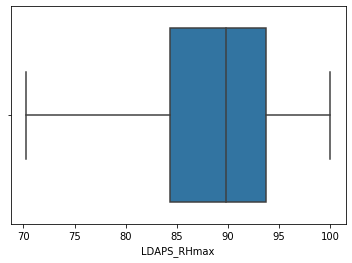

In [39]:
sns.boxplot(data.iloc[:,5]) # creating boxplot after removing outliers.

In [40]:
data.iloc[:,6]=data.iloc[:,6].fillna(data.iloc[:,6].median()) # filling missing values

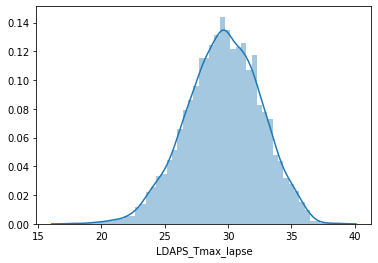

In [41]:
sns.distplot(data.iloc[:,6]) # distribution plot of LDAPS_Tmax_lapse after filling missing value 

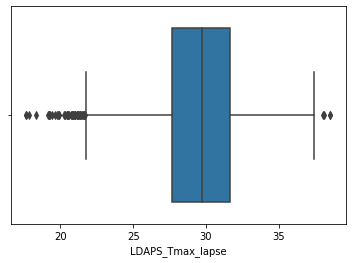

In [42]:
sns.boxplot(data.iloc[:,6]) # boxplot of LDAPS_Tmax_lapse after filling missing value to check outlier

In [43]:
LDAPS_Tmax_lapse_IQR=data.iloc[:,6].quantile(0.75)-data.iloc[:,6].quantile(0.25) # Calculate Inter Quantile Range

In [44]:
data.iloc[:,6].quantile(0.25)-1.5*LDAPS_Tmax_lapse_IQR

21.70700061250001

In [45]:
data.iloc[:,6].quantile(0.75)+1.5*LDAPS_Tmax_lapse_IQR

37.66990939249999

In [46]:
data.iloc[:,6]=np.where(data.iloc[:,6]<21.7104826475,21.7104826475,data.iloc[:,6]) # removing outliers of lower wisker#

In [47]:
data.iloc[:,6]=np.where(data.iloc[:,6]>37.66581782749999,37.66581782749999,data.iloc[:,6]) # removing outliers of upper wisker

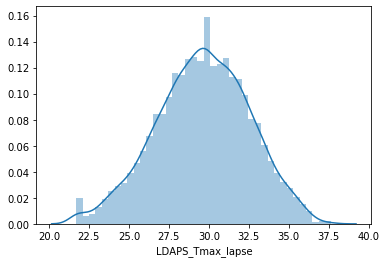

In [48]:
sns.distplot(data.iloc[:,6]) # distribution plot of LDAPS_Tmax_lapse after removing outliers 

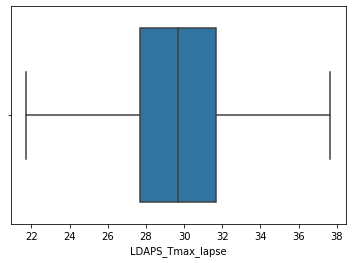

In [49]:
sns.boxplot(data.iloc[:,6]) # box plot of LDAPS_Tmax_lapse after removing outliers 

In [50]:
data.iloc[:,7]=data.iloc[:,7].fillna(data.iloc[:,7].median()) # filling missing value

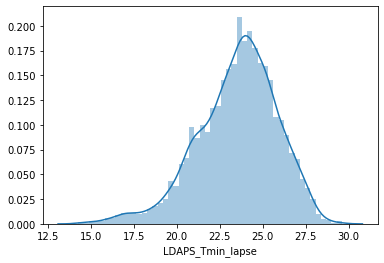

In [51]:
sns.distplot(data.iloc[:,7]) # distribution plot of LDAPS_Tmin_lapse after filling missing values

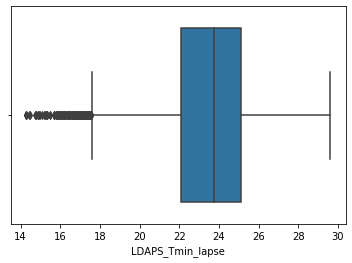

In [52]:
sns.boxplot(data.iloc[:,7]) # box plot of LDAPS_Tmin_lapse after filling missing values

In [53]:
LDAPS_Tmin_lapse_IQR=data.iloc[:,7].quantile(0.75) - data.iloc[:,7].quantile(0.25) # calculate Inter Quantile Range 

In [54]:
data.iloc[:,7].quantile(0.25)-1.5*LDAPS_Tmin_lapse_IQR # calculate lower wisker of  LDAPS_Tmin_lapse

17.585628087500005

In [55]:
data.iloc[:,7]=np.where(data.iloc[:,7]< 17.5879807725,17.5879807725,data.iloc[:,7]) # removing outliers of lower wisker of LDAPS_Tmin_laspe

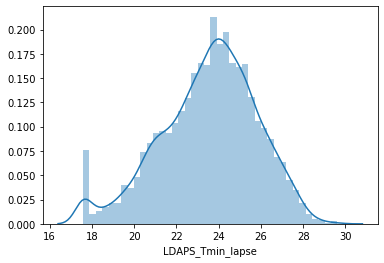

In [56]:
sns.distplot(data.iloc[:,7]) # distribution plot of LDAPS_Tmin_lapse after removing outlier

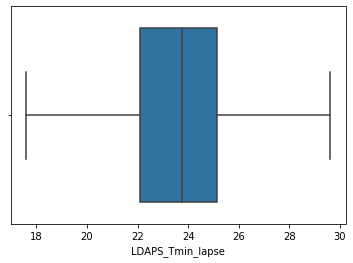

In [57]:
sns.boxplot(data.iloc[:,7]) # box plot of LDAPS_Tmin_lapse after removing outlier

In [58]:
data.iloc[:,8]=data.iloc[:,8].fillna(data.iloc[:,8].median()) # filling missing value 

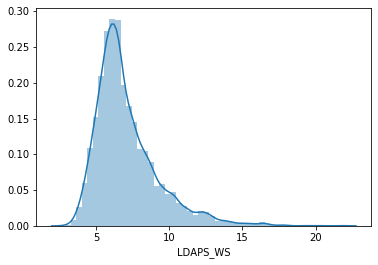

In [59]:
sns.distplot(data.iloc[:,8]) # distribution plot of LDAPS_WS after filling missing value

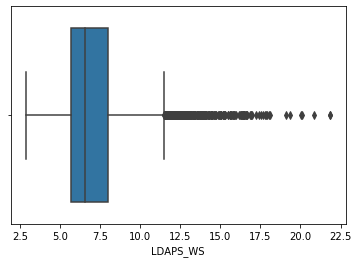

In [60]:
sns.boxplot(data.iloc[:,8]) # box plot of LDAPS_WS after filling missing value

In [61]:
LDAPS_WS_IQR=data.iloc[:,8].quantile(0.75) - data.iloc[:,8].quantile(0.25) # calculating Inter Quantile Range of LDAPS_WS

In [62]:
data.iloc[:,8].quantile(0.25)-1.5*LDAPS_WS_IQR # calculating lowwer wwisker value of LDAPS_WS

2.205011355124999

In [63]:
data.iloc[:,8].quantile(0.75)+ 1.5*LDAPS_WS_IQR # calculating upper wisker value of LDAPS_WS

11.488946982125

In [64]:
data.iloc[:,8]=np.where(data.iloc[:,8]> 11.48, 11.48,data.iloc[:,8]) # removing outlier of upper wisker value of LDAPS_WS

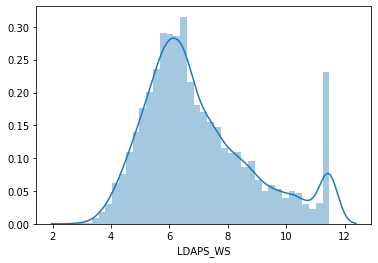

In [65]:
sns.distplot(data.iloc[:,8]) # distribution plot of LDAPS_WS after removing outlier

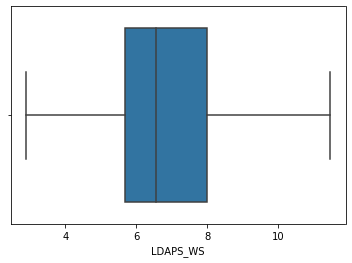

In [66]:
sns.boxplot(data.iloc[:,8]) # box plot of LDAPS_WS after removing outlier

In [67]:
data.iloc[:,9]=data.iloc[:,9].fillna(data.iloc[:,9].median()) # filling missing value

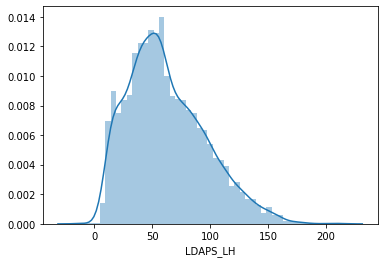

In [68]:
sns.distplot(data.iloc[:,9]) # distributio  plot of LDAPS_LH after filling missing value

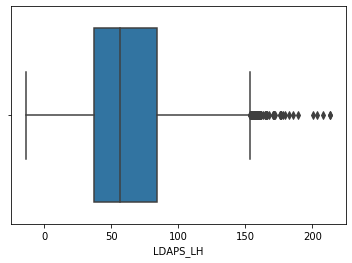

In [69]:
sns.boxplot(data.iloc[:,9]) # box plot of LDAPS_LH to check outlier before filling missing value 

In [70]:
LDAPS_LH_IQR=data.iloc[:,9].quantile(0.75)- data.iloc[:,9].quantile(0.25) # calculaing Intr Quantile Range of LDAPS_LH

In [71]:
data.iloc[:,9].quantile(0.75) + 1.5*LDAPS_LH_IQR

153.4623182625

In [72]:
data.iloc[:,9]=np.where(data.iloc[:,9] > 153.40,153.40,data.iloc[:,9]) # removing outlier of upper wisker value of LDAPS_LH

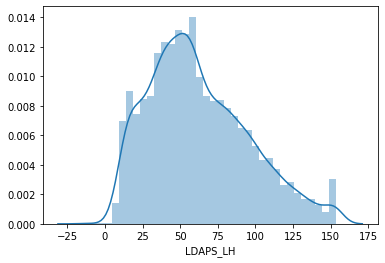

In [73]:
sns.distplot(data.iloc[:,9]) # distribution plot of LDAPS_LH after removing outlier

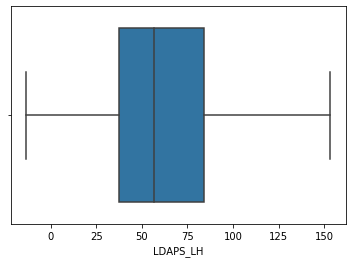

In [74]:
sns.boxplot(data.iloc[:,9]) # box plot of LDAPS_LH after removing outlier

In [75]:
data.iloc[:,10]=data.iloc[:,10].fillna(data.iloc[:,10].mean()) # filling missing value

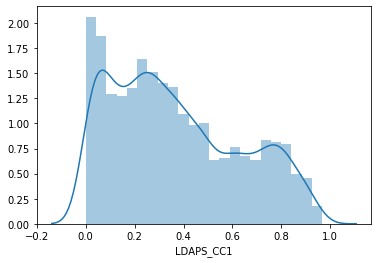

In [76]:
sns.distplot((data.iloc[:,10])) # distribution plot after filling missing value 

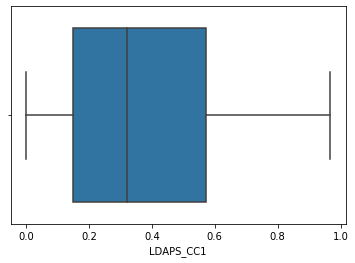

In [77]:
sns.boxplot(data.iloc[:,10])

In [78]:
data.iloc[:,11]=data.iloc[:,11].fillna(data.iloc[:,11].mean()) # filling missing value

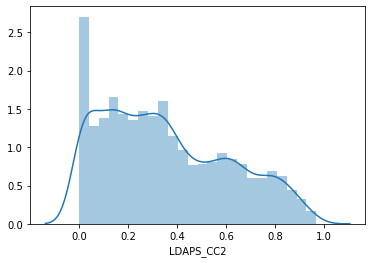

In [79]:
sns.distplot(data.iloc[:,11]) # distribution plot of LDAPS_CC2 after filling missing value

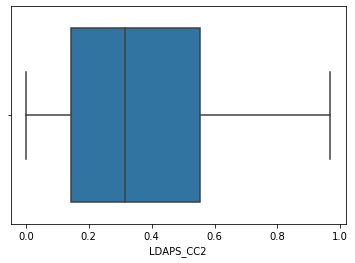

In [80]:
sns.boxplot(data.iloc[:,11]) # box plot of LDAPS_CC2 to check outlier after filling missing value

In [81]:
data.iloc[:,12]=data.iloc[:,12].fillna(data.iloc[:,12].mean()) # filling missing value  

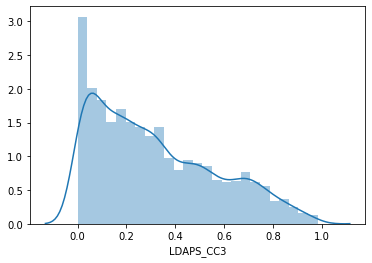

In [82]:
sns.distplot(data.iloc[:,12]) #distribution plot of LDAPS_CC3 after filling missing value

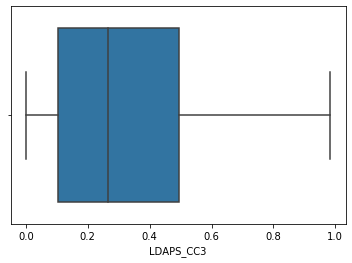

In [83]:
sns.boxplot(data.iloc[:,12]) #box plot of LDAPS_CC3 after filling missing value

In [84]:
data.iloc[:,13]=data.iloc[:,13].fillna(data.iloc[:,13].mean()) # filling missing value

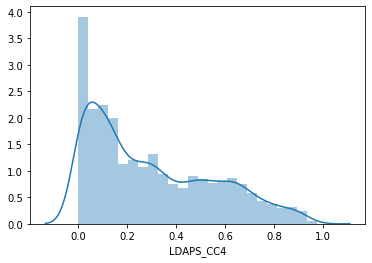

In [85]:
sns.distplot(data.iloc[:,13]) # distribution plot of LDAPS_CC4 after filling missing values

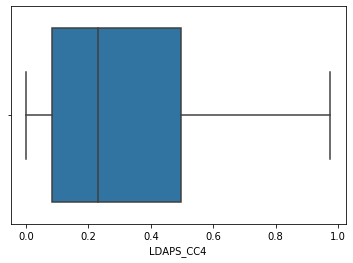

In [86]:
sns.boxplot(data.iloc[:,13]) # box plot of LDAPS_CC4 after filling missing values

In [87]:
data.iloc[:,14]=data.iloc[:,14].fillna(data.iloc[:,14].median()) # filling missing value

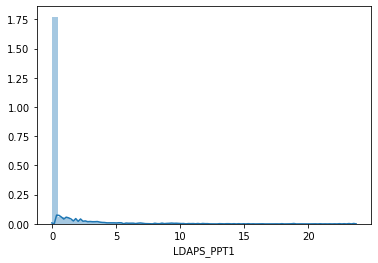

In [88]:
sns.distplot(data.iloc[:,14]) # distribution plot of LDAPS_PPT1 after filling missing value

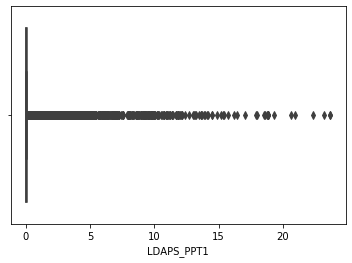

In [89]:
sns.boxplot(data.iloc[:,14]) # box plot of LDAPS_PPT1 to check outlier after filling missing value

In [90]:
LDAPS_PPT1_IQR=data.iloc[:,14].quantile(0.75)-data.iloc[:,14].quantile(0.25) # calculate Inter Quantile Range of LDAPS_PPT1

In [91]:
LDAPS_PPT1_IQR

0.049121697500000006

In [92]:
data.iloc[:,14].quantile(0.75)+1.5*LDAPS_PPT1_IQR # calculate upper wishker

0.12280424375000001

In [93]:
data.iloc[:,14]=np.where(data.iloc[:,14] > 0.12,0.12,data.iloc[:,14]) # replace all the value that greater than upper wishker

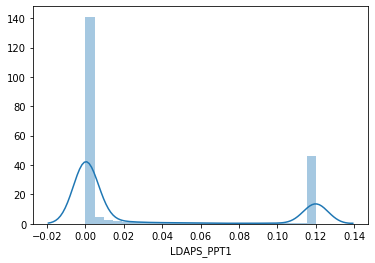

In [94]:
sns.distplot(data.iloc[:,14]) # distribution plot after replace all the value replace with upper wishker value 

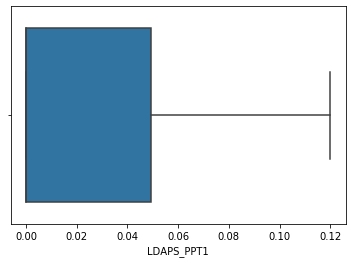

In [95]:
sns.boxplot(data.iloc[:,14]) #box plot to check outliers after replace all the value replace with upper wishker value 

In [96]:
data.iloc[:,15]=data.iloc[:,15].fillna(data.iloc[:,15].median()) # filling missing value

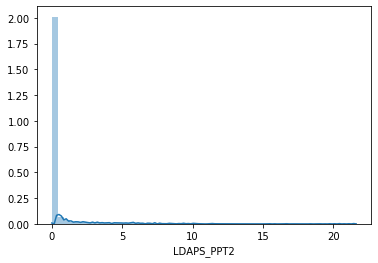

In [97]:
sns.distplot(data.iloc[:,15]) # distribution plot of LDAPS_PPT2 after filling missing value

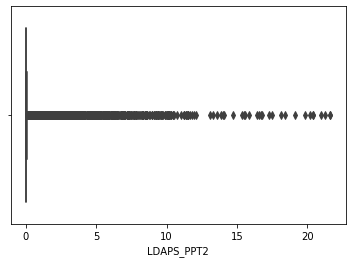

In [98]:
sns.boxplot(data.iloc[:,15]) # box plot of LDAPS_PPT2 to check outlirers after filling missing value

In [99]:
LDAPS_PPT2_IQR=data.iloc[:,15].quantile(0.75) - data.iloc[:,15].quantile(0.25) # calculating Inter Quantile Range

In [100]:
LDAPS_PPT2_IQR

0.016747907

In [101]:
data.iloc[:,15].quantile(0.75) + 1.5* LDAPS_PPT2_IQR # calculate upper wishker

0.0418697675

In [102]:
data.iloc[:,15]=np.where(data.iloc[:,15] > 0.04,0.04,data.iloc[:,15]) # replace all the value that greater than upper wishker

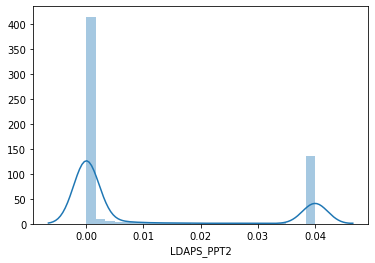

In [103]:
sns.distplot(data.iloc[:,15]) # distribution plot after replace all the value replace with upper wishker value 

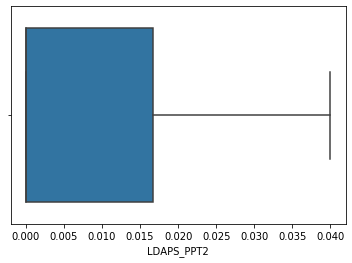

In [104]:
sns.boxplot(data.iloc[:,15]) # box plot after replace all the value replace with upper wishker value 

In [105]:
data.iloc[:,16]=data.iloc[:,16].fillna(data.iloc[:,16].median()) # filling missing values

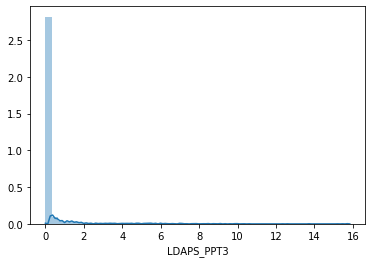

In [106]:
sns.distplot(data.iloc[:,16]) # distribution plot after filling missing value

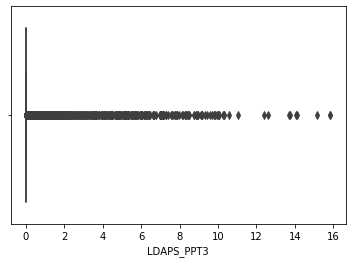

In [107]:
sns.boxplot(data.iloc[:,16]) # box plot after filling missing value

In [108]:
LDAPS_PPT3_IQR=data.iloc[:,16].quantile(0.75) - data.iloc[:,16].quantile(0.25) # calculating Inter Quantile Range

In [109]:
LDAPS_PPT3_IQR

0.0072310325

In [110]:
data.iloc[:,16].quantile(0.75) + 1.5*LDAPS_PPT3_IQR # calculate upper wishker

0.018077581250000002

In [111]:
data.iloc[:,16]=np.where(data.iloc[:,16] > 0.01,0.01,data.iloc[:,16]) # replace the value that is greater than upper wishker values

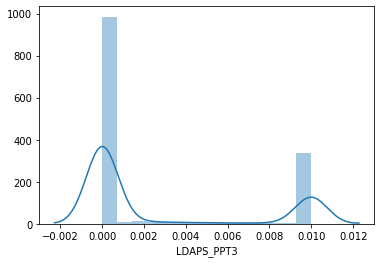

In [112]:
sns.distplot(data.iloc[:,16]) # distribution plot after replace all the value replace with upper wishker value

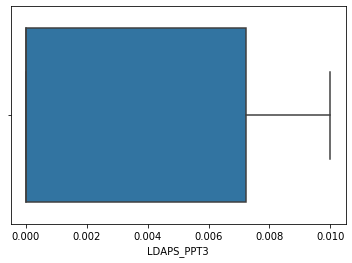

In [113]:
sns.boxplot(data.iloc[:,16]) # box plot after replace all the value replace with upper wishker value

In [114]:
data.iloc[:,17]=data.iloc[:,17].fillna(data.iloc[:,17].median()) # filling all the missing values

In [115]:
LDAPS_PPT4_IQR=data.iloc[:,17].quantile(0.75) - data.iloc[:,17].quantile(0.25) # calculating Inter Quantile Range

In [116]:
data.iloc[:,17].quantile(0.75) + 1.5*LDAPS_PPT4_IQR

0.0

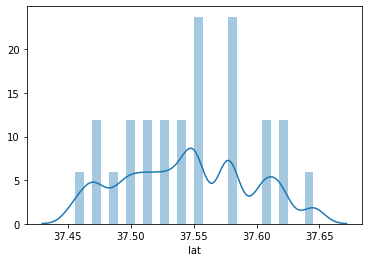

In [117]:
sns.distplot(data.iloc[:,18]) # distribution plot 

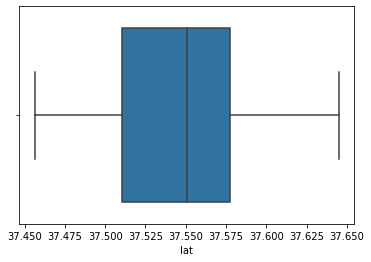

In [118]:
sns.boxplot(data.iloc[:,18]) # box plot to check outliers

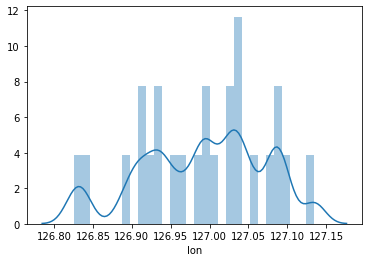

In [119]:
sns.distplot(data.iloc[:,19]) # distribution plot of longitude

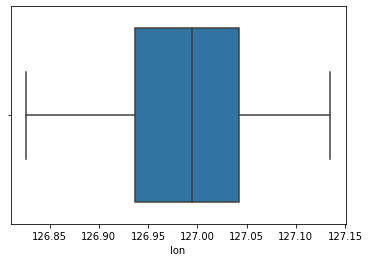

In [120]:
sns.boxplot(data.iloc[:,19]) # box plot for checking outliers

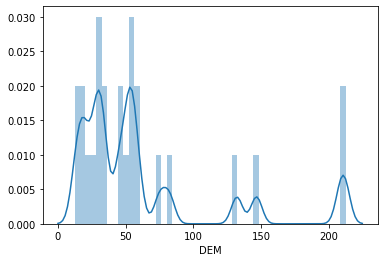

In [121]:
sns.distplot(data.iloc[:,20]) # distribution plot

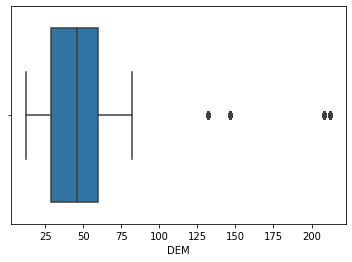

In [122]:
sns.boxplot(data.iloc[:,20]) # box plot for checking outliers

In [123]:
DEM_IQR=data.iloc[:,20].quantile(0.75) - data.iloc[:,20].quantile(0.25) # calculatig Inter Quantile Range of DEM

In [124]:
DEM_IQR

31.1324

In [125]:
data.iloc[:,20].quantile(0.75) + 1.5* DEM_IQR # calculating upper wishker

106.531

In [126]:
data.iloc[:,20]=np.where(data.iloc[:,20] > 106.53,106.53,data.iloc[:,20]) # replace the value that is greater than upper wishker values

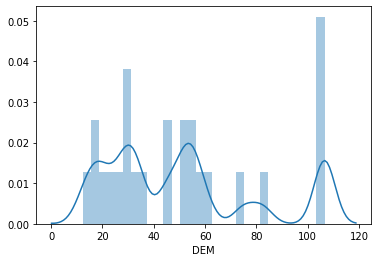

In [127]:
sns.distplot(data.iloc[:,20]) # distribution plot after replace all values greater than the upper wishker values

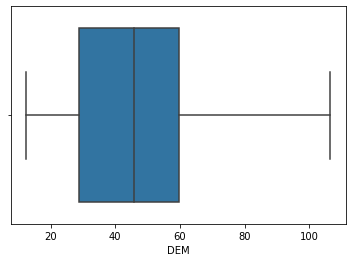

In [128]:
sns.boxplot(data.iloc[:,20]) # box plot after replace all values greater than the upper wishker values to check outliers

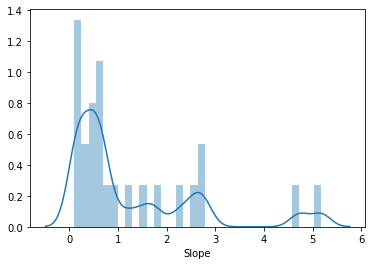

In [129]:
sns.distplot(data.iloc[:,21]) # distribution plot of slope

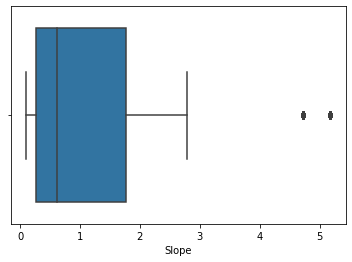

In [130]:
sns.boxplot(data.iloc[:,21]) # box plot of slope to check outliers

In [131]:
slope_IQR=data.iloc[:,21].quantile(0.75) - data.iloc[:,21].quantile(0.25) # calculating Inter Quantile Range of slope column 

In [132]:
slope_IQR

1.4965000000000002

In [133]:
data.iloc[:,21].quantile(0.75)+1.5 * slope_IQR # calculating upper wishker

4.01255

In [134]:
data.iloc[:,21]=np.where(data.iloc[:,21] > 4.01,4.01, data.iloc[:,21]) # replace the value that is greater than upper wishker values

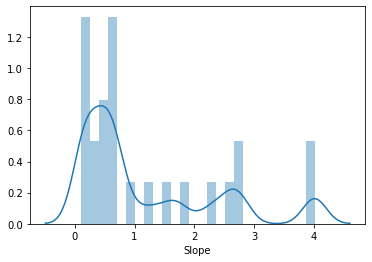

In [135]:
sns.distplot(data.iloc[:,21]) # distribution plot after replace all values greater than the upper wishker values 

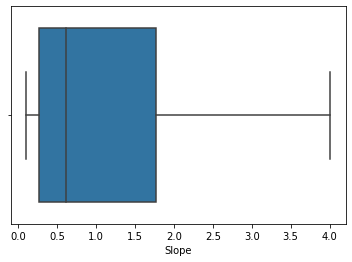

In [136]:
 sns.boxplot(data.iloc[:,21]) # box plot after replace all values greater than the upper wishker values to check outliers

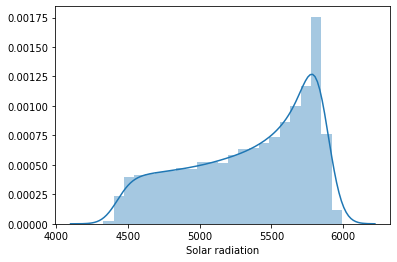

In [137]:
sns.distplot(data.iloc[:,22]) # distribution plot of Solar radiation

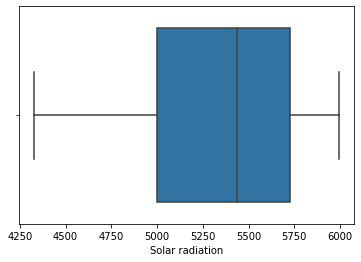

In [138]:
sns.boxplot(data.iloc[:,22]) # box plot of Solar radiation to check outliers

In [139]:
data.iloc[:,-1] = data.iloc[:,-1].astype(str) # convert Target_min to string

In [140]:
data = data[data.iloc[:,-1] != 'nan'] # to check all the data without nan value

In [141]:
data.iloc[:,-1] = data.iloc[:,-1].astype(float) # to convert the data string to float value and save in the same column

In [142]:
data.LDAPS_LH.isna().sum()

0

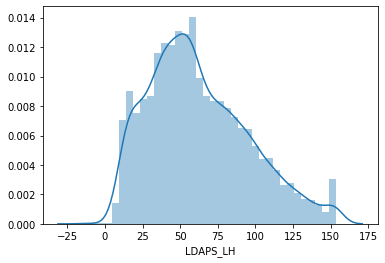

In [143]:
sns.distplot(data.LDAPS_LH)

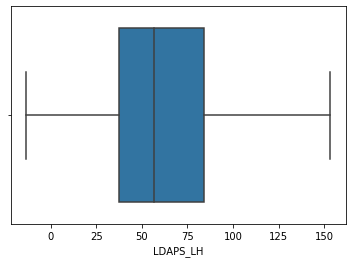

In [144]:
sns.boxplot(data.LDAPS_LH)

In [145]:
data.LDAPS_LH=data.LDAPS_LH.fillna(data.LDAPS_LH.mean())

In [146]:
data.loc[:,['lat', 'lon']]

,lat,lon
0,37.6046,126.991
1,37.6046,127.032
2,37.5776,127.058
3,37.6450,127.022
4,37.5507,127.135
5,37.5102,127.042
6,37.5776,126.838
7,37.4697,126.910
8,37.4967,126.826
9,37.4562,126.955


In [147]:
data.filter(['station', 'lon', 'lat','Next_Tmin'])[data.filter(['station', 'lon', 'lat','Next_Tmin']).iloc[:,0] == 5.0]

,station,lon,lat,Next_Tmin
4,5.0,127.135,37.5507,22.5
29,5.0,127.135,37.5507,22.2
54,5.0,127.135,37.5507,20.8
79,5.0,127.135,37.5507,23.3
104,5.0,127.135,37.5507,22.4
129,5.0,127.135,37.5507,22.9
154,5.0,127.135,37.5507,21.6
179,5.0,127.135,37.5507,23.2
204,5.0,127.135,37.5507,23.8
229,5.0,127.135,37.5507,24.3


In [148]:
data.filter(['station', 'lon', 'lat'])

,station,lon,lat
0,1.0,126.991,37.6046
1,2.0,127.032,37.6046
2,3.0,127.058,37.5776
3,4.0,127.022,37.6450
4,5.0,127.135,37.5507
5,6.0,127.042,37.5102
6,7.0,126.838,37.5776
7,8.0,126.910,37.4697
8,9.0,126.826,37.4967
9,10.0,126.955,37.4562


In [149]:
data.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [150]:
data.groupby(['station']).Next_Tmin.sum()

station
1.0     6477.1
2.0     6780.8
3.0     7175.3
4.0     7221.8
5.0     6943.3
6.0     7283.2
7.0     7192.6
8.0     7212.4
9.0     7083.7
10.0    6717.7
11.0    7192.6
12.0    6780.6
13.0    7326.4
14.0    7214.1
15.0    7091.4
16.0    6737.8
17.0    6598.2
18.0    7348.8
19.0    6909.5
20.0    7022.0
21.0    7312.4
22.0    7249.4
23.0    7414.5
24.0    7429.5
25.0    7395.2
Name: Next_Tmin, dtype: float64

In [151]:
data.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [152]:
z = []
for i in range(len(data.columns)):
    z.append(data.iloc[:,i].nunique())

In [153]:
z_columns = ['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin']

In [154]:
data_frame = pd.DataFrame({'Column_name':z_columns, 'unique_Values':z})

In [155]:
data_frame = data_frame.sort_values('unique_Values')                                  

In [156]:
data_frame

,Column_name,unique_Values
18,lat,12
20,DEM,22
0,station,25
21,Slope,25
19,lon,25
3,Present_Tmin,126
24,Next_Tmin,157
2,Present_Tmax,159
23,Next_Tmax,183
1,Date,310


In [157]:
data1 = data.sort_values(list(data_frame.Column_name))

In [158]:
data = data.loc[:,list(data_frame.Column_name)]

In [159]:
data.sort_values('lat')

,lat,DEM,station,Slope,lon,Present_Tmin,Next_Tmin,Present_Tmax,Next_Tmax,Date,LDAPS_PPT3,LDAPS_PPT2,LDAPS_PPT1,Solar radiation,LDAPS_PPT4,LDAPS_WS,LDAPS_RHmax,LDAPS_CC4,LDAPS_Tmin_lapse,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_LH,LDAPS_Tmax_lapse,LDAPS_RHmin
1834,37.4562,106.5300,10.0,4.010000,126.955,21.5000,21.4,31.8,28.3,2014-07-11,0.000000,0.000000,0.000000,5791.912598,0.000000,9.515396,91.577148,4.727772e-01,22.008748,0.103023,2.899152e-01,5.428327e-01,35.563932,25.491272,75.735970
4334,37.4562,106.5300,10.0,4.010000,126.955,23.2000,22.3,32.4,30.0,2015-08-18,0.000000,0.000000,0.000000,4843.271973,0.000000,4.625549,91.812439,7.178464e-01,22.784800,0.201343,2.575172e-01,6.246879e-01,45.121144,27.871997,56.417377
2009,37.4562,106.5300,10.0,4.010000,126.955,20.8000,22.6,29.1,29.1,2014-07-18,0.000000,0.000000,0.000000,5686.123535,0.000000,7.603943,97.168762,8.702637e-02,22.638001,0.318308,1.913432e-01,8.452750e-02,55.823188,29.589339,54.482655
259,37.4562,106.5300,10.0,4.010000,126.955,24.5000,23.7,25.9,24.9,2013-07-10,0.000000,0.006910,0.029339,5804.408691,0.000000,11.480000,97.551018,5.842952e-01,22.995407,0.763012,5.255675e-01,6.522174e-01,33.004435,26.320968,74.894096
2734,37.4562,106.5300,10.0,4.010000,126.955,19.8000,21.4,28.6,24.4,2014-08-16,0.010000,0.040000,0.011118,4915.099121,0.000000,4.619649,96.351830,5.993142e-01,20.362187,0.405218,7.832732e-01,7.434929e-01,30.746224,25.032725,64.218796
4359,37.4562,106.5300,10.0,4.010000,126.955,22.4000,22.5,30.0,27.1,2015-08-19,0.000000,0.000000,0.000000,4806.566406,0.000000,5.729259,87.862923,5.431168e-01,23.475424,0.441590,4.292725e-01,3.643665e-01,43.770000,26.864131,62.338768
6259,37.4562,106.5300,10.0,4.010000,126.955,22.7000,22.0,25.2,26.4,2017-07-02,0.008126,0.040000,0.120000,5880.977539,0.035086,11.480000,99.846237,8.838007e-01,21.766777,0.858430,8.327148e-01,6.958059e-01,23.297106,24.092815,90.281334
934,37.4562,106.5300,10.0,4.010000,126.955,22.6000,24.3,27.0,32.0,2013-08-06,0.000000,0.000000,0.040053,5239.571777,0.000000,6.258690,93.420616,7.111540e-02,23.640071,0.508891,4.484318e-01,1.496011e-01,68.867695,31.225823,58.136024
1984,37.4562,106.5300,10.0,4.010000,126.955,21.0000,20.6,27.5,29.7,2014-07-17,0.010000,0.040000,0.120000,5703.202637,0.062666,7.963501,99.259544,3.943063e-01,22.242068,0.817668,6.882502e-01,3.472729e-01,49.866208,24.837915,86.754898
3584,37.4562,106.5300,10.0,4.010000,126.955,20.3000,21.4,28.2,29.7,2015-07-19,0.000000,0.000000,0.000000,5668.401855,0.000839,5.731230,87.178940,4.586195e-01,22.958733,0.383028,4.001846e-01,2.657368e-01,54.941985,30.379445,53.547691


In [160]:
data=data.sort_values(list(data.columns))

In [161]:
data.drop(['lat','lon'],axis=1,inplace=True)

In [162]:
data.sort_index()

,DEM,station,Slope,Present_Tmin,Next_Tmin,Present_Tmax,Next_Tmax,Date,LDAPS_PPT3,LDAPS_PPT2,LDAPS_PPT1,Solar radiation,LDAPS_PPT4,LDAPS_WS,LDAPS_RHmax,LDAPS_CC4,LDAPS_Tmin_lapse,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_LH,LDAPS_Tmax_lapse,LDAPS_RHmin
0,106.5300,1.0,2.785000,21.4000,21.2,28.7,29.1,2013-06-30,0.000000,0.000000,0.000000,5992.895996,0.000000,6.818887,91.116364,1.309282e-01,23.006936,0.233947,2.038957e-01,1.616969e-01,69.451805,28.074101,58.255688
1,44.7624,2.0,0.514100,21.6000,22.5,31.9,30.5,2013-06-30,0.000000,0.000000,0.000000,5869.312500,0.000000,5.691890,90.604721,1.277273e-01,24.035009,0.225508,2.517714e-01,1.594441e-01,51.937448,29.850689,52.263397
2,33.3068,3.0,0.266100,23.3000,23.9,31.6,31.1,2013-06-30,0.000000,0.000000,0.000000,5863.555664,0.000000,6.138224,83.973587,1.421253e-01,24.565633,0.209344,2.574694e-01,2.040915e-01,20.573050,30.091292,48.690479
3,45.7160,4.0,2.534800,23.4000,24.3,32.0,31.7,2013-06-30,0.000000,0.000000,0.000000,5856.964844,0.000000,5.650050,96.483688,1.342487e-01,23.326177,0.216372,2.260024e-01,1.611574e-01,65.727144,29.704629,58.239788
4,35.0380,5.0,0.505500,21.9000,22.5,31.4,31.2,2013-06-30,0.000000,0.000000,0.000000,5859.552246,0.000000,5.735004,90.155128,1.700210e-01,23.486480,0.151407,2.499953e-01,1.788925e-01,107.965535,29.113934,56.174095
5,54.6384,6.0,0.145700,23.5000,24.0,31.9,31.5,2013-06-30,0.000000,0.000000,0.000000,5873.780762,0.000000,6.182295,85.307251,1.463629e-01,23.822613,0.185279,2.808180e-01,2.328410e-01,50.231389,29.219342,52.437126
6,12.3700,7.0,0.098500,24.4000,23.4,31.4,30.9,2013-06-30,0.000000,0.000000,0.000000,5849.233398,0.000000,5.587135,81.019760,1.457054e-01,24.238467,0.389600,3.335700e-01,2.704190e-01,125.110007,28.551859,56.287189
7,52.5180,8.0,1.562900,23.6000,22.9,32.1,31.1,2013-06-30,0.000000,0.000000,0.000000,5863.992188,0.000000,6.104417,78.004539,1.438406e-01,23.819054,0.357856,3.449281e-01,2.723873e-01,42.011547,28.851982,52.326218
8,50.9312,9.0,0.412500,22.0000,21.6,31.4,31.3,2013-06-30,0.000000,0.000000,0.000000,5876.901367,0.000000,6.017135,80.784607,1.489111e-01,23.332373,0.408766,3.448003e-01,2.649796e-01,85.110971,28.426975,55.338791
9,106.5300,10.0,4.010000,20.5000,21.0,31.6,30.5,2013-06-30,0.000000,0.000000,0.000000,5893.608398,0.000000,6.518841,86.849632,1.354435e-01,22.527018,0.348292,3.062548e-01,2.452542e-01,63.006075,27.576705,56.651203


In [165]:
len(data)

7725

In [167]:
data.index = range(7725)

In [168]:
data.head()

,DEM,station,Slope,Present_Tmin,Next_Tmin,Present_Tmax,Next_Tmax,Date,LDAPS_PPT3,LDAPS_PPT2,LDAPS_PPT1,Solar radiation,LDAPS_PPT4,LDAPS_WS,LDAPS_RHmax,LDAPS_CC4,LDAPS_Tmin_lapse,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_LH,LDAPS_Tmax_lapse,LDAPS_RHmin
0,12.37,NaN,0.098475,16.9375,11.3,21.5,17.4,NaN,0.00,0.0,0.0,4329.520508,0.000000,2.882580,70.241386,0.000000,17.587981,0.000000,0.000000,0.000000,-13.603212,21.710483,19.794666
1,106.53,10.0,4.010000,16.9375,13.9,21.8,21.9,2017-08-29,0.00,0.0,0.0,4413.500000,0.000000,4.949621,74.612885,0.118997,17.587981,0.611891,0.663251,0.489990,42.855331,21.710483,45.357285
2,106.53,10.0,4.010000,16.9375,15.0,21.5,26.2,2017-08-30,0.00,0.0,0.0,4371.684570,0.000000,6.542819,86.536469,0.007272,17.587981,0.038369,0.044792,0.000000,69.655613,25.878358,25.229910
3,106.53,10.0,4.010000,16.9375,15.4,25.1,29.2,2015-07-03,0.00,0.0,0.0,5873.690430,0.000000,5.960075,77.303032,0.036444,17.739008,0.029365,0.000000,0.209645,57.815186,27.056648,37.651024
4,106.53,10.0,4.010000,16.9375,15.5,25.2,23.6,2016-08-29,0.01,0.0,0.0,4371.684570,0.448519,11.480000,91.422478,0.852382,17.587981,0.224562,0.222634,0.706695,62.789151,21.710483,57.631237


In [169]:
data[data.Date == '2013-07-03'].loc[:,['station','Date']].sort_values('station')

,station,Date
6512,1.0,2013-07-03
6243,2.0,2013-07-03
5293,3.0,2013-07-03
7458,4.0,2013-07-03
4381,5.0,2013-07-03
2196,6.0,2013-07-03
4957,7.0,2013-07-03
334,8.0,2013-07-03
1565,9.0,2013-07-03
37,10.0,2013-07-03


In [170]:
data.head()

,DEM,station,Slope,Present_Tmin,Next_Tmin,Present_Tmax,Next_Tmax,Date,LDAPS_PPT3,LDAPS_PPT2,LDAPS_PPT1,Solar radiation,LDAPS_PPT4,LDAPS_WS,LDAPS_RHmax,LDAPS_CC4,LDAPS_Tmin_lapse,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_LH,LDAPS_Tmax_lapse,LDAPS_RHmin
0,12.37,NaN,0.098475,16.9375,11.3,21.5,17.4,NaN,0.00,0.0,0.0,4329.520508,0.000000,2.882580,70.241386,0.000000,17.587981,0.000000,0.000000,0.000000,-13.603212,21.710483,19.794666
1,106.53,10.0,4.010000,16.9375,13.9,21.8,21.9,2017-08-29,0.00,0.0,0.0,4413.500000,0.000000,4.949621,74.612885,0.118997,17.587981,0.611891,0.663251,0.489990,42.855331,21.710483,45.357285
2,106.53,10.0,4.010000,16.9375,15.0,21.5,26.2,2017-08-30,0.00,0.0,0.0,4371.684570,0.000000,6.542819,86.536469,0.007272,17.587981,0.038369,0.044792,0.000000,69.655613,25.878358,25.229910
3,106.53,10.0,4.010000,16.9375,15.4,25.1,29.2,2015-07-03,0.00,0.0,0.0,5873.690430,0.000000,5.960075,77.303032,0.036444,17.739008,0.029365,0.000000,0.209645,57.815186,27.056648,37.651024
4,106.53,10.0,4.010000,16.9375,15.5,25.2,23.6,2016-08-29,0.01,0.0,0.0,4371.684570,0.448519,11.480000,91.422478,0.852382,17.587981,0.224562,0.222634,0.706695,62.789151,21.710483,57.631237


In [171]:
data.drop(['LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','Date'],axis=1,inplace=True) #drop low frequency column and date

In [172]:
data.groupby(['DEM','station']).size().reset_index()

,DEM,station,0
0,12.3700,7.0,306
1,15.5876,23.0,310
2,17.2956,24.0,309
3,19.5844,25.0,310
4,21.9668,22.0,308
5,26.2980,21.0,310
6,28.7000,11.0,308
7,30.0464,15.0,308
8,30.9680,14.0,310
9,33.3068,3.0,310


In [173]:
data.drop('DEM', axis=1,inplace=True) # drop DEM because of multicollinearity With station

In [174]:
x = data.groupby(['station','Slope']).size().reset_index()

In [175]:
x.sort_values('Slope')

,station,Slope,0
6,7.0,0.0985,306
21,22.0,0.1332,308
5,6.0,0.1457,306
22,23.0,0.1554,310
23,24.0,0.2223,309
2,3.0,0.2661,310
24,25.0,0.2713,310
8,9.0,0.4125,310
4,5.0,0.5055,305
1,2.0,0.5141,310


In [176]:
data.drop('Slope',axis=1,inplace=True) # drop Slope column because of multicollinearity with station

In [177]:
data.head()

,station,Present_Tmin,Next_Tmin,Present_Tmax,Next_Tmax,Solar radiation,LDAPS_WS,LDAPS_RHmax,LDAPS_CC4,LDAPS_Tmin_lapse,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_LH,LDAPS_Tmax_lapse,LDAPS_RHmin
0,NaN,16.9375,11.3,21.5,17.4,4329.520508,2.882580,70.241386,0.000000,17.587981,0.000000,0.000000,0.000000,-13.603212,21.710483,19.794666
1,10.0,16.9375,13.9,21.8,21.9,4413.500000,4.949621,74.612885,0.118997,17.587981,0.611891,0.663251,0.489990,42.855331,21.710483,45.357285
2,10.0,16.9375,15.0,21.5,26.2,4371.684570,6.542819,86.536469,0.007272,17.587981,0.038369,0.044792,0.000000,69.655613,25.878358,25.229910
3,10.0,16.9375,15.4,25.1,29.2,5873.690430,5.960075,77.303032,0.036444,17.739008,0.029365,0.000000,0.209645,57.815186,27.056648,37.651024
4,10.0,16.9375,15.5,25.2,23.6,4371.684570,11.480000,91.422478,0.852382,17.587981,0.224562,0.222634,0.706695,62.789151,21.710483,57.631237


In [178]:
target_min=data.pop('Next_Tmin')
target_max=data.pop('Next_Tmax')

In [179]:
station_dummy=pd.get_dummies(data.station)

In [180]:
station_dummy.columns=range(1,26)

In [181]:
data.drop('station',axis=1,inplace=True)

In [182]:
data=pd.concat([data,station_dummy],axis=1)

In [183]:
X = np.append(arr = np.ones((len(data), 1)).astype(int), values = data, axis = 1)

In [184]:
X=pd.DataFrame(X)

In [185]:
X.columns=['intercept','Present_Tmin',     'Present_Tmax',  'Solar radiation',
               'LDAPS_WS',        'LDAPS_CC4', 'LDAPS_Tmin_lapse',
            'LDAPS_RHmax',        'LDAPS_CC1',        'LDAPS_CC2',
              'LDAPS_CC3',         'LDAPS_LH', 'LDAPS_Tmax_lapse',
            'LDAPS_RHmin',                  1,                  2,
                        3,                  4,                  5,
                        6,                  7,                  8,
                        9,                 10,                 11,
                       12,                 13,                 14,
                       15,                 16,                 17,
                       18,                 19,                 20,
                       21,                 22,                 23,
                       24,                 25]

In [186]:
import statsmodels.api as sm
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()

In [187]:
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1211.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        20:31:57   Log-Likelihood:                -10493.
No. Observations:                7725   AIC:                         2.106e+04
Df Residuals:                    7686   BIC:                         2.134e+04
Df Model:                          38                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -5.1465      0.724  

In [188]:
X.drop('LDAPS_Tmin_lapse',axis=1,inplace=True)

In [189]:
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1243.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        20:31:57   Log-Likelihood:                -10493.
No. Observations:                7725   AIC:                         2.106e+04
Df Residuals:                    7687   BIC:                         2.133e+04
Df Model:                          37                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -5.1529      0.724  

In [190]:
X.drop(5,axis=1,inplace=True)

In [191]:
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1275.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        20:31:57   Log-Likelihood:                -10500.
No. Observations:                7725   AIC:                         2.107e+04
Df Residuals:                    7688   BIC:                         2.133e+04
Df Model:                          36                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -2.6761      0.295  

In [192]:
X.drop('Solar radiation',axis=1,inplace=True)

In [193]:
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1312.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        20:31:57   Log-Likelihood:                -10500.
No. Observations:                7725   AIC:                         2.107e+04
Df Residuals:                    7689   BIC:                         2.132e+04
Df Model:                          35                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -2.6817      0.283  

In [194]:
X.drop(25,axis=1,inplace=True)

In [195]:
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1351.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        20:31:57   Log-Likelihood:                -10500.
No. Observations:                7725   AIC:                         2.107e+04
Df Residuals:                    7690   BIC:                         2.131e+04
Df Model:                          34                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -2.7118      0.276  

In [196]:
X.drop(21,axis=1,inplace=True)

In [197]:
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1392.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        20:31:57   Log-Likelihood:                -10501.
No. Observations:                7725   AIC:                         2.107e+04
Df Residuals:                    7691   BIC:                         2.131e+04
Df Model:                          33                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -2.7274      0.275  

In [198]:
X.drop(11,axis=1,inplace=True)

In [199]:
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1435.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        20:31:57   Log-Likelihood:                -10501.
No. Observations:                7725   AIC:                         2.107e+04
Df Residuals:                    7692   BIC:                         2.130e+04
Df Model:                          32                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -2.7467      0.274  

In [200]:
X.drop('LDAPS_CC3',axis=1,inplace=True)

In [201]:
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.856
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1479.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        20:31:57   Log-Likelihood:                -10507.
No. Observations:                7725   AIC:                         2.108e+04
Df Residuals:                    7693   BIC:                         2.130e+04
Df Model:                          31                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -2.9144      0.270  

In [218]:
X.drop('LDAPS_CC2',axis=1,inplace=True)

In [219]:
regressor_OLS = sm.OLS(endog = target_min, exog =X).fit()
print(regressor_OLS.summary())

                            OLS Regression Results                            
Dep. Variable:              Next_Tmin   R-squared:                       0.856
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     1528.
Date:                Mon, 20 Apr 2020   Prob (F-statistic):               0.00
Time:                        21:24:10   Log-Likelihood:                -10508.
No. Observations:                7725   AIC:                         2.108e+04
Df Residuals:                    7694   BIC:                         2.129e+04
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
intercept           -2.8934      0.270  

In [220]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(X,target_min,test_size=0.25,random_state=0)

In [221]:
from sklearn.preprocessing import StandardScaler
scale_data=StandardScaler()

In [222]:
x_train = scale_data.fit_transform(x_train)

In [223]:
x_test = scale_data.transform(x_test)

In [224]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import Ridge
from sklearn import linear_model
import xgboost
from sklearn.pipeline import Pipeline

In [225]:
pipeline_dtr=Pipeline([('dsc_Regressor',DecisionTreeRegressor())])

In [226]:
pipeline_rfr=Pipeline([('random_forest_regressor',RandomForestRegressor())])

In [227]:
pipeline_linear_reg=Pipeline([('Linear_regression',LinearRegression())])

In [228]:
pipeline_XGB=Pipeline([('Lasso regression',xgboost.XGBRegressor())])

In [229]:
pipeline_lasso=Pipeline([('Xgb_regressor',linear_model.Lasso())])

In [230]:
pipeline_ridge=Pipeline([('Ridge_regression',Ridge())])

In [231]:
pipeline_svr=Pipeline([('support vector_regression',SVR())])

In [232]:
pipe_dictonary={0:'DecisionTreeRegressor',1 :'RandomForestRegressor', 2 : 'LinearRegression', 3:'XGB Regressor', 4 : 'Lasso_regression', 5 : 'Ridge Regressor', 6: 'support vector_regression'}

In [233]:
pipelines=[pipeline_dtr,pipeline_rfr,pipeline_linear_reg,pipeline_XGB,pipeline_lasso,pipeline_ridge,pipeline_svr]
for pipes in pipelines:
    pipes.fit(x_train,y_train)
        

[21:24:38] WARNING: C:/Jenkins/workspace/xgboost-win64_release_0.90/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [234]:
for i,model in enumerate(pipelines):
    print('R-Sq Value {}  test data : {}'.format(pipe_dictonary[i],model.score(x_test,y_test)))

R-Sq Value DecisionTreeRegressor  test data : 0.729902924901654
R-Sq Value RandomForestRegressor  test data : 0.8775555653906582
R-Sq Value LinearRegression  test data : 0.845484509791522
R-Sq Value XGB Regressor  test data : 0.8551219517784446
R-Sq Value Lasso_regression  test data : 0.6347912621671439
R-Sq Value Ridge Regressor  test data : 0.8454834088171128
R-Sq Value support vector_regression  test data : 0.8459061662864757


In [235]:
for i,model in enumerate(pipelines):
    print('R-Sq Value {} of train dataset : {}'.format(pipe_dictonary[i],model.score(x_train,y_train)))

R-Sq Value DecisionTreeRegressor of train dataset : 1.0
R-Sq Value RandomForestRegressor of train dataset : 0.9839743676618086
R-Sq Value LinearRegression of train dataset : 0.8592855749006273
R-Sq Value XGB Regressor of train dataset : 0.886289691346153
R-Sq Value Lasso_regression of train dataset : 0.6349751851130048
R-Sq Value Ridge Regressor of train dataset : 0.8592855177299892
R-Sq Value support vector_regression of train dataset : 0.8766057464452475
